# Sparse Reward

## Q-network for Mountain Car (Discrete)

1. Implement DQN and tune it and show that code is working, but it can not solve the problem.

2. Reward-Shaping. Describe and implememt artifical reward function to solve the problem under 2000 episodes.

You can calculate the rewards based on the total energy of the system.

3. Implement [reservse curriculum](https://bair.berkeley.edu/blog/2017/12/20/reverse-curriculum/) method to solve MointainCar Discrete or [Hindsight Experience Replay](https://openai.com/index/hindsight-experience-replay/). (you can use libraries or frameworks)

It will be nice to have some comparison or conclusion about rewards shaping and implemented method.

4. Solve MountainCar Continuous using any modifications for sparse reward problems + RL-method from stable baselines or other popular methods implementation.

In [4]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import random
from collections import deque
from IPython.display import clear_output, display
import matplotlib.pyplot as plt
from collections import namedtuple, deque

import gymnasium as gym

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

Device: cuda


In [5]:
SEED = 10
torch.manual_seed(SEED)
np.random.seed(SEED)
random.seed(SEED)

## Energy-Based Reward Shaping

To address the sparse-reward nature of MountainCar and help the agent learn the swing-up strategy more efficiently, an energy-based reward shaping term was added. The idea is based on the physical intuition that the car must accumulate enough mechanical energy (potential + kinetic) to reach the goal at the top of the right hill.

At each step, the agent receives a reward proportional to the change in total energy of the system:

- The potential energy term is approximated from the hillside geometry.

- The kinetic energy term is derived from the velocity of the car.

- The combined energy is normalized so that the maximum reachable energy corresponds to a value near 1.

The shaped reward is computed as: 
    
    reward = 0.01 * original_reward + (energy(next_state) - energy(state))

This means the agent is explicitly rewarded for actions that increase mechanical energy, which are exactly the actions needed to perform the swinging motion required to reach the top. Additionally, a small bonus is added when the agent crosses the goal position (x >= 0.5) to reinforce successful episodes.

This shaping provides a smooth, informative learning signal even when the agent is far from the goal, significantly accelerating the learning process compared to using the sparse reward alone.


In [5]:
from IPython.display import clear_output, display
import matplotlib.pyplot as plt

def plot_live(losses, durations, rewards):
    clear_output(wait=True)
    plt.close('all')   # removes all old figures
    
    fig = plt.figure(figsize=(12,4))

    # Loss Curve
    ax1 = fig.add_subplot(1,2,1)
    ax1.plot(losses, label="loss")
    ax1.set_xlabel("Training Step")
    ax1.set_ylabel("Loss")
    ax1.set_title("Loss During Training")
    ax1.legend()

    # Episode Duration
    # ax2 = fig.add_subplot(1,2,2)
    # ax2.plot(durations, label="episode length")
    # ax2.set_xlabel("Episode")
    # ax2.set_ylabel("Steps Survived")
    # ax2.set_title("Episode Durations")
    # ax2.legend()

    ax2 = fig.add_subplot(1,2,2)
    ax2.plot(rewards, label="episode length")
    ax2.set_xlabel("Episode")
    ax2.set_ylabel("Steps Survived")
    ax2.set_title("Episode Durations")
    ax2.legend()

    fig.tight_layout()
    display(fig)

In [7]:
class QNetwork(nn.Module):
    def __init__(self, n_states, n_actions, hidden_dim=64):
        super(QNetwork, self).__init__()
        self.fc1 = nn.Linear(n_states, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, n_actions)
        self.to(device)

    def forward(self, state):
        x = F.relu(self.fc1(state))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [4]:
Transition = namedtuple(
    "Transition", ("state", "action", "reward", "next_state", "done")
)

class ReplayBuffer(object):
    def __init__(self, capacity, batch_size):
        self.memory = deque([], maxlen=capacity)
        self.batch_size = batch_size

    def push(self, *args):
        """Save a transition"""
        self.memory.append(Transition(*args))

    def sample(self):
        return random.sample(self.memory, self.batch_size)

    def __len__(self):
        return len(self.memory)

In [5]:
class DQNAgent:
    def __init__(self, n_states, n_actions, hidden_dim=128, batch_size=32, lr=5e-4):
        self.n_states = n_states
        self.n_actions = n_actions
        self.batch_size = batch_size

        self.policy_net = QNetwork(n_states, n_actions, hidden_dim).to(device)
        self.target_net = QNetwork(n_states, n_actions, hidden_dim).to(device)

        # Initial sync of target network
        self.target_net.load_state_dict(self.policy_net.state_dict())
        self.target_net.eval()

        self.optimizer = optim.Adam(self.policy_net.parameters(), lr=lr)
        self.memory = ReplayBuffer(capacity=int(1e5), batch_size=batch_size)

    def act(self, state, eps=0.0):
        """ε-greedy action selection."""
        if np.random.random() < eps:
            return np.random.randint(self.n_actions)

        state_tensor = torch.from_numpy(state).float().unsqueeze(0).to(device)
        with torch.no_grad():
            q_values = self.policy_net(state_tensor)
        return q_values.argmax(dim=1).item()

    def learn(self, experiences, gamma):
        """Double DQN update."""
        states, actions, rewards, next_states, dones = zip(*experiences)

        states      = torch.from_numpy(np.vstack(states)).float().to(device)
        actions     = torch.from_numpy(np.vstack(actions)).long().to(device)
        rewards     = torch.from_numpy(np.vstack(rewards)).float().to(device)
        next_states = torch.from_numpy(np.vstack(next_states)).float().to(device)
        dones       = torch.from_numpy(np.vstack(dones).astype(np.uint8)).float().to(device)

        # -----------------------------
        # Double DQN target:
        #   online net selects best action, target net evaluates it
        # -----------------------------
        with torch.no_grad():
            # Online net chooses best action in next state
            next_q_online = self.policy_net(next_states)
            best_actions = next_q_online.argmax(1, keepdim=True)  # [B, 1]

            # Target net evaluates those actions
            next_q_target = self.target_net(next_states)
            Q_targets_next = next_q_target.gather(1, best_actions)  # [B, 1]

            # Bellman target
            Q_targets = rewards + gamma * Q_targets_next * (1.0 - dones)

        # Current Q estimates
        Q_expected = self.policy_net(states).gather(1, actions)

        # Loss (Huber)
        loss = F.smooth_l1_loss(Q_expected, Q_targets)

        # Optimize
        self.optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(self.policy_net.parameters(), 1.0)
        self.optimizer.step()

        # Soft target update
        self.soft_update(self.policy_net, self.target_net, tau=0.005)

        return loss.item()

    @staticmethod
    def soft_update(local_model, target_model, tau):
        """θ_target ← τθ_local + (1 − τ)θ_target"""
        for target_param, local_param in zip(
            target_model.parameters(), local_model.parameters()
        ):
            target_param.data.copy_(
                tau * local_param.data + (1.0 - tau) * target_param.data
            )

In [8]:
import gymnasium as gym
env = gym.make("MountainCar-v0")

env.reset(seed=SEED)
env.action_space.seed(SEED)
env.observation_space.seed(SEED)

num_episodes = 5000
max_steps_per_episode = 200

epsilon_start = 0.9
epsilon_end = 0.02
epsilon_decay_rate = 0.995

gamma = 0.99
buffer_size = 10000
batch_size = 32
train_every = 8          # learn every N env steps
learn_start = 1000       # warmup before learning

state_dim = env.observation_space.shape[0]
action_dim = env.action_space.n

agent = DQNAgent(state_dim, action_dim, batch_size=batch_size, lr=5e-4)

The energy(state) function estimates how close the MountainCar is to reaching the goal by computing a normalized mechanical energy value for each state. The car needs enough mechanical energy (potential + kinetic) to climb the right hill and reach the target at `x=0.5`. The reward shaping uses this energy value to guide the agent toward energy-increasing actions.

The energy function consists of three main components:

- **Potential Energy Approximation**

  The environment's hills are shaped like a sinusoidal curve. The height of the hill at position x is approximated by:

  `h = sin(x − π/2 + 0.5) + 1.0`

  This expression shifts and scales the sine wave so that the height is always positive.

  Potential energy is then proportional to: `u = m * g * h`

- **Kinetic Energy**

  The car’s velocity contributes kinetic energy:

  `k = 1/2 * v^2`

  This term encourages the agent to accelerate when needed to build momentum for the swing-up motion.

- **Normalization**

  To keep energy values between 0 and 1, a scaling factor n is computed from the maximum possible energy the car can have:

  `n = 1 / (max potential + max kinetic)`

  This ensures the energy measure remains numerically stable and comparable across states.

  The final normalized energy is:

  `e = n * (u + k)`


This value increases as the car climbs higher on the hills or builds more speed, making it a meaningful proxy for "progress" toward the goal. By rewarding the increase in energy between states, the agent receives a dense and informative learning signal that reflects the physics of the environment.

In [9]:
def energy(state):
    x = state[0]
    v = state[1]
    m = 1.0
    g = 0.0025
    h = np.sin((x - (0.5 * np.pi)) + 0.5) + 1.0
    u = m * g * h
    k = 0.5 * v * v
    xmax = 0.6
    vmax = 0.07
    n = 1 / ((m * g * (np.sin((xmax - (0.5 * np.pi)) + 0.5) + 1.0)) + (0.5 * vmax * vmax))
    e = n * (u + k)
    return e

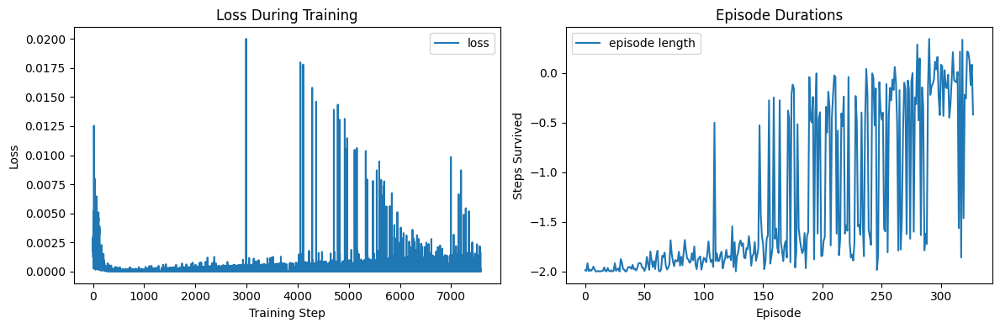


 Environment solved at episode 327!
Stopping training early...

Training Finished!


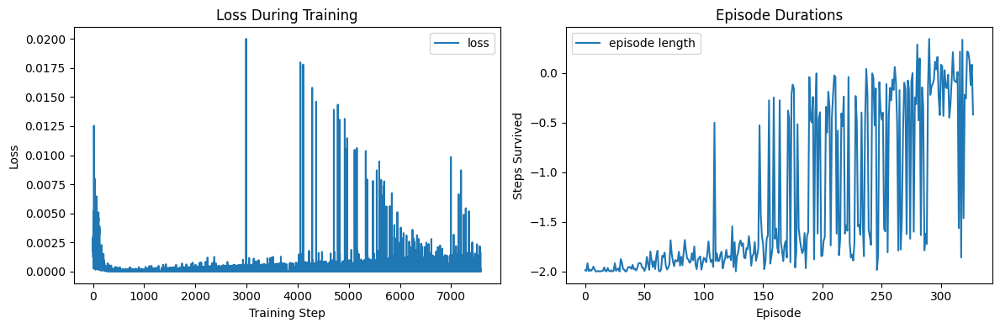

In [10]:
episode_durations = []
rewards_history = []
loss_history = []
state_reached = []
train_step = 0

for episode in range(num_episodes):
    state, _ = env.reset()
    epsilon = max(epsilon_end, epsilon_start * (epsilon_decay_rate ** episode))

    steps_this_episode = 0
    rewards = 0

    for t in range(max_steps_per_episode):
        steps_this_episode += 1
        train_step += 1

        # ε-greedy action
        action = agent.act(state, eps=epsilon)

        next_state, reward, terminated, truncated, info = env.step(action)
        done = terminated or truncated

        # Reward shaping
        reward = (reward * 0.01) + (energy(next_state) - energy(state))
        if next_state[0] >= 0.5 :
            reward = reward + 1.0
        else :
            reward = reward

        rewards += reward
        
        # For terminal transitions, zero out next_state
        if done:
            next_state_zeroed = np.zeros_like(state)
        else:
            next_state_zeroed = next_state

        # Store transition
        agent.memory.push(state, action, reward, next_state_zeroed, done)

        state = next_state

        # Learn
        if (
            len(agent.memory) > learn_start
            and train_step % train_every == 0
        ):
            batch = agent.memory.sample()
            loss = agent.learn(batch, gamma)
            loss_history.append(loss)

        if done:
            if(state[0]>=0.5):
                state_reached.append(1)
            else:
                state_reached.append(0)
            break

    episode_durations.append(steps_this_episode)
    rewards_history.append(rewards)

    # Live plot
    plot_live(loss_history, episode_durations, rewards_history)

    # Early Stopping Check
    # if len(episode_durations) > 50:
    #     avg_last_50 = np.mean(episode_durations[-50:])
    #     if avg_last_50 >= 195:
    #         print(f"\n Environment solved at episode {episode}!")
    #         print("Stopping training early...\n")
    #         break
    if np.mean(state_reached[-50:]) >= 0.85:
        print(f"\n Environment solved at episode {episode}!")
        print("Stopping training early...\n")
        break   
print("Training Finished!")

In [11]:
from IPython.display import Image, display
import imageio

def evaluate_policy(env_id, agent, episodes=5, render=False):
    render_mode = "rgb_array" if render else None
    env = gym.make(env_id, render_mode=render_mode)

    returns = []
    frames = []
    MAX_FRAMES = 1500

    for ep in range(episodes):
        obs, info = env.reset()
        done = False
        episode_return = 0

        while not done:
            action = agent.act(obs, eps=0.0)
            obs, reward, terminated, truncated, info = env.step(action)
            done = terminated or truncated
            episode_return += reward

            # Safe frame capture
            if render and len(frames) < MAX_FRAMES:
                frame = env.render()
                frames.append(frame)

        print(f"Episode {ep} return = {episode_return:.1f}")
        returns.append(episode_return)

    env.close()

    if render:
        print("Saving GIF...")
        imageio.mimsave("eval.gif", frames, fps=20)
        display(Image(filename="eval.gif"))

    return np.mean(returns), np.std(returns)

/usr/local/lib/python3.11/dist-packages/pygame/pkgdata.py:25: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import resource_stream, resource_exists
/usr/local/lib/python3.11/dist-packages/pkg_resources/__init__.py:3154: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('google')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-packages
  declare_namespace(pkg)
/usr/local/lib/python3.11/dist-packages/pkg_resources/__init__.py:3154: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('google.cloud')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-pa

Episode 0 return = -86.0
Episode 1 return = -88.0
Episode 2 return = -111.0
Episode 3 return = -87.0
Episode 4 return = -111.0
Saving GIF...


/usr/local/lib/python3.11/dist-packages/imageio/plugins/pillow.py:409: DeprecationWarning: The keyword `fps` is no longer supported. Use `duration`(in ms) instead, e.g. `fps=50` == `duration=20` (1000 * 1/50).
  warnings.warn(


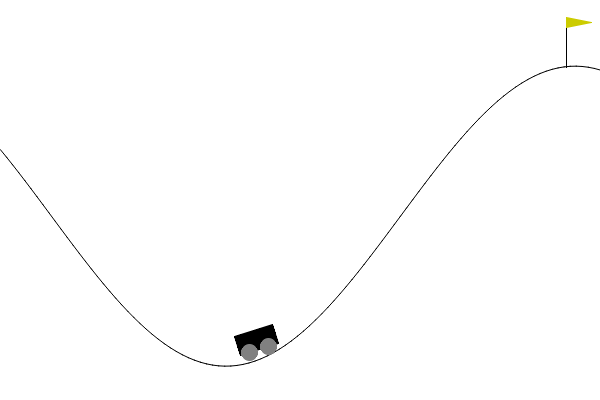

Eval return: -96.6 ± 11.77454882362802


In [12]:
mean_ret, std_ret = evaluate_policy(
    "MountainCar-v0",
    agent,
    episodes=5,
    render=True
)

print("Eval return:", mean_ret, "±", std_ret)


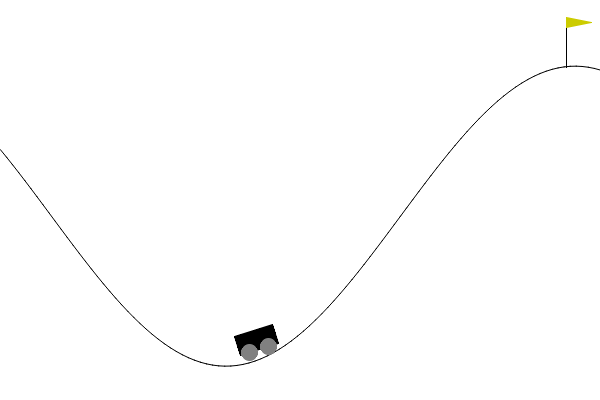

In [13]:
from IPython.display import HTML
import base64

path = "/kaggle/working/eval.gif"
gif = base64.b64encode(open(path,'rb').read()).decode('ascii')

HTML(f'<img src="data:image/gif;base64,{gif}" width="700px">')

## Reverse Curriculum

In the standard MountainCar environment, the agent starts far from the goal and must learn the swing-up strategy purely through exploration, which is slow and unstable for value-based methods. To simplify the learning problem, I used a reverse curriculum in which training begins from states very close to the goal (e.g., 0.45-0.50), where reaching the target is easy. Once the agent reliably succeeds from these near-goal states, the starting range is gradually expanded backwards toward more difficult positions. This creates a smooth learning progression where the agent first masters short-horizon control, then medium-horizon control, and eventually the full MountainCar task. This approach significantly accelerates learning and stabilizes training compared to starting every episode from the default, hard initial state.

In [6]:
from IPython.display import clear_output, display
import matplotlib.pyplot as plt

def plot_live(losses, durations, rewards, title="Episode Durations"):
    clear_output(wait=True)
    plt.close('all')   # removes all old figures
    
    fig = plt.figure(figsize=(12,4))

    # Loss Curve
    ax1 = fig.add_subplot(1,2,1)
    ax1.plot(losses, label="loss")
    ax1.set_xlabel("Training Step")
    ax1.set_ylabel("Loss")
    ax1.set_title("Loss During Training")
    ax1.legend()

    # Episode Duration
    # ax2 = fig.add_subplot(1,2,2)
    # ax2.plot(durations, label="episode length")
    # ax2.set_xlabel("Episode")
    # ax2.set_ylabel("Steps Survived")
    # ax2.set_title("Episode Durations")
    # ax2.legend()

    ax2 = fig.add_subplot(1,2,2)
    ax2.plot(rewards, label="episode length")
    ax2.set_xlabel("Episode")
    ax2.set_ylabel("Steps Survived")
    ax2.set_title(title)
    ax2.legend()

    fig.tight_layout()
    display(fig)

In [7]:
class QNetwork(nn.Module):
    def __init__(self, n_states, n_actions, hidden_dim=64):
        super(QNetwork, self).__init__()
        self.fc1 = nn.Linear(n_states, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, n_actions)
        self.to(device)

    def forward(self, state):
        x = F.relu(self.fc1(state))
        x = F.relu(self.fc2(x))
        return self.fc3(x)

In [8]:
Transition = namedtuple(
    "Transition", ("state", "action", "reward", "next_state", "done")
)

class ReplayBuffer(object):
    def __init__(self, capacity, batch_size):
        self.memory = deque([], maxlen=capacity)
        self.batch_size = batch_size

    def push(self, *args):
        """Save a transition"""
        self.memory.append(Transition(*args))

    def sample(self):
        return random.sample(self.memory, self.batch_size)

    def __len__(self):
        return len(self.memory)

In [9]:
class DQNAgent:
    def __init__(self, n_states, n_actions, hidden_dim=128, batch_size=32, lr=5e-4):
        self.n_states = n_states
        self.n_actions = n_actions
        self.batch_size = batch_size

        self.policy_net = QNetwork(n_states, n_actions, hidden_dim).to(device)
        self.target_net = QNetwork(n_states, n_actions, hidden_dim).to(device)

        # Initial sync of target network
        self.target_net.load_state_dict(self.policy_net.state_dict())
        self.target_net.eval()

        self.optimizer = optim.Adam(self.policy_net.parameters(), lr=lr)
        self.memory = ReplayBuffer(capacity=int(1e5), batch_size=batch_size)

    def act(self, state, eps=0.0):
        """ε-greedy action selection."""
        if np.random.random() < eps:
            return np.random.randint(self.n_actions)

        state_tensor = torch.from_numpy(state).float().unsqueeze(0).to(device)
        with torch.no_grad():
            q_values = self.policy_net(state_tensor)
        return q_values.argmax(dim=1).item()

    def learn(self, experiences, gamma):
        """Double DQN update."""
        states, actions, rewards, next_states, dones = zip(*experiences)

        states      = torch.from_numpy(np.vstack(states)).float().to(device)
        actions     = torch.from_numpy(np.vstack(actions)).long().to(device)
        rewards     = torch.from_numpy(np.vstack(rewards)).float().to(device)
        next_states = torch.from_numpy(np.vstack(next_states)).float().to(device)
        dones       = torch.from_numpy(np.vstack(dones).astype(np.uint8)).float().to(device)

        # -----------------------------
        # Double DQN target:
        #   online net selects best action, target net evaluates it
        # -----------------------------
        with torch.no_grad():
            # Online net chooses best action in next state
            next_q_online = self.policy_net(next_states)
            best_actions = next_q_online.argmax(1, keepdim=True)  # [B, 1]

            # Target net evaluates those actions
            next_q_target = self.target_net(next_states)
            Q_targets_next = next_q_target.gather(1, best_actions)  # [B, 1]

            # Bellman target
            Q_targets = rewards + gamma * Q_targets_next * (1.0 - dones)

        # Current Q estimates
        Q_expected = self.policy_net(states).gather(1, actions)

        # Loss (Huber)
        loss = F.smooth_l1_loss(Q_expected, Q_targets)

        # Optimize
        self.optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(self.policy_net.parameters(), 1.0)
        self.optimizer.step()

        # Soft target update
        self.soft_update(self.policy_net, self.target_net, tau=0.005)

        return loss.item()

    @staticmethod
    def soft_update(local_model, target_model, tau):
        """θ_target ← τθ_local + (1 − τ)θ_target"""
        for target_param, local_param in zip(
            target_model.parameters(), local_model.parameters()
        ):
            target_param.data.copy_(
                tau * local_param.data + (1.0 - tau) * target_param.data
            )

In [10]:
class ReverseCurriculumMountainCar(gym.Env):
    def __init__(self, start_low=0.45, start_high=0.5, expand_step=0.1):
        super().__init__()
        self.env = gym.make("MountainCar-v0")
        self.start_low = start_low
        self.start_high = start_high
        self.expand_step = expand_step

        self.observation_space = self.env.observation_space
        self.action_space = self.env.action_space

        self.episode_success = False
        self.success_history = []

    def reset(self, seed=None, options=None):
        # Log the previous episode outcome
        if hasattr(self, "episode_finished") and self.episode_finished:
            self.success_history.append(int(self.episode_success))

        # Reset episode flags
        self.episode_success = False
        self.episode_finished = False

        # Reset underlying env
        obs, info = self.env.reset(seed=seed)

        # Override initial position with curriculum schedule
        pos = np.random.uniform(self.start_low, self.start_high)
        vel = 0.0
        state = np.array([pos, vel], dtype=np.float32)

        # set env's internal state
        self.env.unwrapped.state = state.copy()

        return state, info

    def step(self, action):
        state, reward, terminated, truncated, info = self.env.step(action)
        done = terminated or truncated

        # Mark episode success correctly
        if state[0] >= 0.5:
            self.episode_success = True

        if done:
            self.episode_finished = True

        return state, reward, terminated, truncated, info

    def update_curriculum(self):
        # Only update once there is enough episode-level data
        if len(self.success_history) >= 50:
            mean_success = np.mean(self.success_history[-50:])
            print(f"Episode-based success rate: {mean_success:.2f}")

            if mean_success > 0.7:
                self.start_low -= self.expand_step
                self.start_low = max(self.start_low, -1.2)
                print(f"Reverse Curriculum: start_low -> {self.start_low:.2f}")

In [11]:
env = ReverseCurriculumMountainCar()

env.reset(seed=SEED)
env.action_space.seed(SEED)
env.observation_space.seed(SEED)

num_episodes = 5000
max_steps_per_episode = 200

epsilon_start = 0.9
epsilon_end = 0.02
epsilon_decay_rate = 0.995

gamma = 0.99
buffer_size = 10000
batch_size = 32
train_every = 8          # learn every N env steps
learn_start = 1000       # warmup before learning

state_dim = env.observation_space.shape[0]
action_dim = env.action_space.n

agent = DQNAgent(state_dim, action_dim, batch_size=batch_size, lr=5e-4)

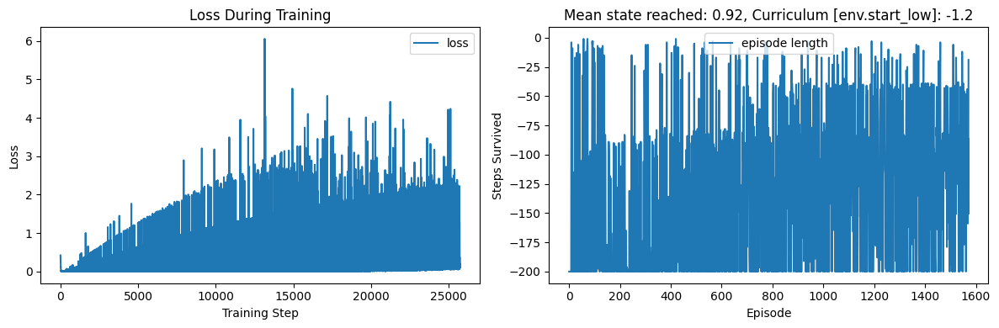


 Environment solved at episode 1571!
Training Finished!


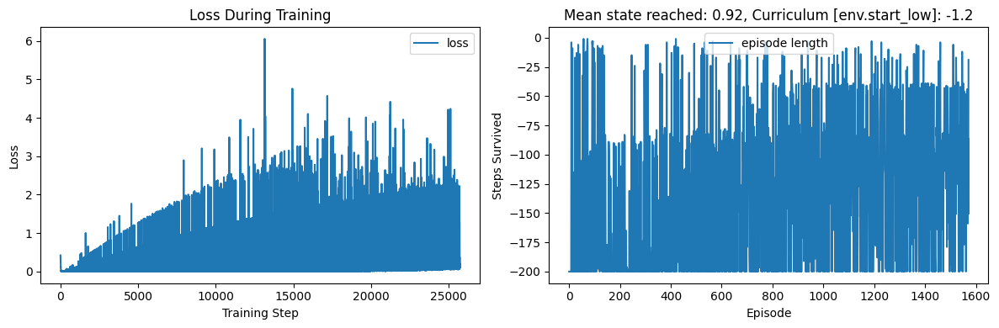

In [12]:
episode_durations = []
rewards_history = []
loss_history = []
state_reached = []
train_step = 0

for episode in range(num_episodes):
    state, _ = env.reset()
    epsilon = max(epsilon_end, epsilon_start * (epsilon_decay_rate ** episode))

    steps_this_episode = 0
    rewards = 0
    episode_success = False

    for t in range(max_steps_per_episode):
        steps_this_episode += 1
        train_step += 1

        # ε-greedy action
        action = agent.act(state, eps=epsilon)

        next_state, reward, terminated, truncated, info = env.step(action)
        done = terminated or truncated

        rewards += reward

        # success detection
        if next_state[0] >= 0.5:
            episode_success = True

        # For terminal transitions, zero out next_state
        if done:
            next_state_zeroed = np.zeros_like(next_state)
        else:
            next_state_zeroed = next_state

        # Store transition
        agent.memory.push(state, action, reward, next_state_zeroed, done)

        state = next_state

        # Learn
        if len(agent.memory) > learn_start and train_step % train_every == 0:
            batch = agent.memory.sample()
            loss = agent.learn(batch, gamma)
            loss_history.append(loss)

        if done:
            state_reached.append(int(episode_success))
            break

    # update reverse curriculum after episode
    env.update_curriculum()

    episode_durations.append(steps_this_episode)
    rewards_history.append(rewards)

    # Live plot
    if len(state_reached) >= 50:
        plot_live(loss_history, episode_durations, rewards_history, f"Mean state reached: {np.mean(state_reached[-50:])}, Curriculum [env.start_low]: {env.start_low}")
    else:
        plot_live(loss_history, episode_durations, rewards_history)

    # Early Stopping Check
    # if len(state_reached) >= 50 and np.mean(state_reached[-50:]) >= 0.8:
    # Make curriculum expand further BEFORE early stopping
    if env.start_low <= -1.1 and np.mean(state_reached[-100:]) >= 0.9:
        print(f"\n Environment solved at episode {episode}!")
        break   

print("Training Finished!")

In [16]:
from IPython.display import Image, display, Video
import imageio
import subprocess

# def evaluate_policy(env_id, agent, episodes=5, render=False):
#     render_mode = "rgb_array" if render else None
#     env = gym.make(env_id, render_mode=render_mode)

#     returns = []
#     frames = []
#     MAX_FRAMES = 1500

#     for ep in range(episodes):
#         obs, info = env.reset()
#         done = False
#         episode_return = 0

#         while not done:
#             action = agent.act(obs, eps=0.0)
#             obs, reward, terminated, truncated, info = env.step(action)
#             done = terminated or truncated
#             episode_return += reward

#             # Safe frame capture
#             if render and len(frames) < MAX_FRAMES:
#                 frame = env.render()
#                 frames.append(frame)

#         print(f"Episode {ep} return = {episode_return:.1f}")
#         returns.append(episode_return)

#     env.close()

    # if render:
    #     print("Saving GIF...")
    #     imageio.mimsave("eval.gif", frames, fps=20)
    #     display(Image(filename="eval.gif"))

    # return np.mean(returns), np.std(returns)

def evaluate_policy(env_id, agent, episodes=5, render=False):
    render_mode = "rgb_array" if render else None
    env = gym.make(env_id, render_mode=render_mode)

    returns = []
    frames = []
    MAX_FRAMES = 1500

    for ep in range(episodes):
        obs, info = env.reset()
        done = False
        episode_return = 0

        while not done:
            action = agent.act(obs, eps=0.0)
            obs, reward, terminated, truncated, info = env.step(action)
            done = terminated or truncated
            episode_return += reward

            # Capture frames for video
            if render and len(frames) < MAX_FRAMES:
                frame = env.render()
                frames.append(frame)

        print(f"Episode {ep} return = {episode_return:.1f}")
        returns.append(episode_return)

    env.close()

    if render:
        print("Saving GIF...")
        imageio.mimsave("rev_cur_eval.gif", frames, fps=20)

        # Convert GIF → MP4 (Kaggle-friendly)
        print("Converting GIF to MP4...")
        subprocess.call([
            "ffmpeg", "-y", "-i", "rev_cur_eval.gif",
            "-movflags", "faststart",
            "-pix_fmt", "yuv420p",
            "rev_cur_eval.mp4"
        ])

        # Display MP4 inside notebook
        print("Displaying MP4:")
        display(Video("rev_cur_eval.mp4", embed=True))

        # Save to Kaggle Output
        # import shutil
        # shutil.copy("rev_cur_eval.mp4", "/kaggle/working/rev_cur_eval.mp4")

    return np.mean(returns), np.std(returns)


In [18]:
mean_ret, std_ret = evaluate_policy(
    "MountainCar-v0",
    agent,
    episodes=10,
    render=True
)

print("Eval return:", mean_ret, "±", std_ret)

error: XDG_RUNTIME_DIR not set in the environment.


Episode 0 return = -153.0
Episode 1 return = -160.0
Episode 2 return = -87.0
Episode 3 return = -86.0
Episode 4 return = -150.0
Episode 5 return = -160.0
Episode 6 return = -115.0
Episode 7 return = -86.0
Episode 8 return = -156.0
Episode 9 return = -146.0
Saving GIF...
Converting GIF to MP4...


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

Displaying MP4:


[mp4 @ 0x58fcb167fe80] Starting second pass: moving the moov atom to the beginning of the file
frame= 1299 fps=427 q=-1.0 Lsize=     301kB time=00:01:04.80 bitrate=  38.1kbits/s dup=3 drop=0 speed=21.3x    
video:287kB audio:0kB subtitle:0kB other streams:0kB global headers:0kB muxing overhead: 4.934574%
[libx264 @ 0x58fcb1680fc0] frame I:6     Avg QP:12.61  size:  3992
[libx264 @ 0x58fcb1680fc0] frame P:654   Avg QP:15.27  size:   284
[libx264 @ 0x58fcb1680fc0] frame B:639   Avg QP:19.08  size:   131
[libx264 @ 0x58fcb1680fc0] consecutive B-frames: 23.4% 28.2% 14.5% 33.9%
[libx264 @ 0x58fcb1680fc0] mb I  I16..4: 40.5% 51.4%  8.1%
[libx264 @ 0x58fcb1680fc0] mb P  I16..4:  0.1%  0.2%  0.1%  P16..4:  0.5%  0.4%  0.4%  0.0%  0.0%    skip:98.3%
[libx264 @ 0x58fcb1680fc0] mb B  I16..4:  0.0%  0.1%  0.0%  B16..8:  1.0%  0.5%  0.2%  direct: 0.1%  skip:98.1%  L0:49.7% L1:41.0% BI: 9.3%
[libx264 @ 0x58fcb1680fc0] 8x8 transform intra:52.7% inter:2.5%
[libx264 @ 0x58fcb1680fc0] coded y,uvDC,uvAC 

Eval return: -129.9 ± 30.994999596709143



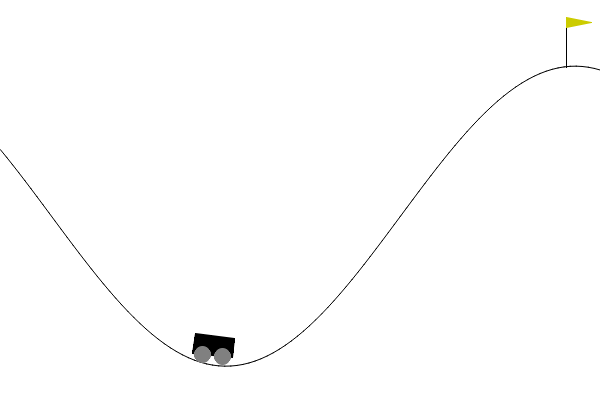

In [19]:
from IPython.display import HTML
import base64

path = "/kaggle/working/rev_cur_eval.gif"
gif = base64.b64encode(open(path,'rb').read()).decode('ascii')

HTML(f'<img src="data:image/gif;base64,{gif}" width="700px">')

## SAC + Mountain Car Continuous 

<p>Continuous version uses dense reward:</p>

<p>
  r<sub>t</sub> = 100 · 1[position &ge; 0.45] − 0.1 · a<sub>t</sub><sup>2</sup>
</p>

In [61]:
import argparse
import os
import sys
import random
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.distributions import Normal
import collections
import matplotlib.pyplot as plt
from tqdm import tqdm

In [62]:
# %config Completer.use_jedi = False
# os.environ["MUJOCO_GL"] = "osmesa"

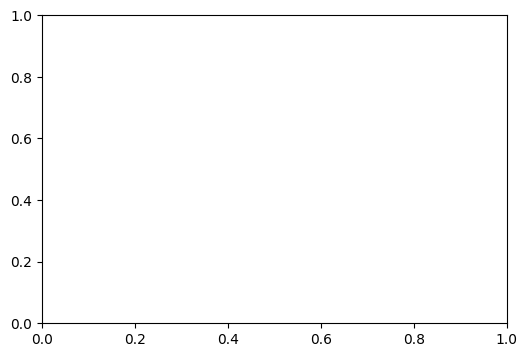

In [63]:
from IPython.display import display, clear_output

returns_history = []
fig, ax = plt.subplots(figsize=(6,4))

def update_plot():
    clear_output(wait=True)
    ax.clear()
    ax.plot(returns_history)
    ax.set_xlabel("Episode")
    ax.set_ylabel("Return")
    ax.set_title("Training Curve")
    display(fig)

In [64]:
class ReplayBuffer:
    def __init__(self, capacity, obs_dim, action_dim, device):
        self.capacity = capacity
        self.ptr = 0
        self.size = 0
        self.device = device
    
        self.obs = np.zeros((capacity, obs_dim), dtype=np.float32)
        self.next_obs = np.zeros((capacity, obs_dim), dtype=np.float32)
        self.actions = np.zeros((capacity, action_dim), dtype=np.float32)
        self.rewards = np.zeros((capacity, 1), dtype=np.float32)
        self.dones = np.zeros((capacity, 1), dtype=np.float32)
    
        # normalization statistics (fixed for MountainCar)
        self.obs_mean = np.array([-0.3, 0.0], dtype=np.float32)
        self.obs_std  = np.array([0.5, 0.03], dtype=np.float32)
    
    def add(self, obs, action, reward, next_obs, done):
        self.obs[self.ptr] = obs
        self.actions[self.ptr] = action
        self.rewards[self.ptr] = reward
        self.next_obs[self.ptr] = next_obs
        self.dones[self.ptr] = done
    
        self.ptr = (self.ptr + 1) % self.capacity
        self.size = min(self.size + 1, self.capacity)
    
    def normalize_obs(self, obs):
        return (obs - self.obs_mean) / (self.obs_std + 1e-8)
    
    def sample(self, batch_size):
        idx = np.random.randint(0, self.size, size=batch_size)
        
        obs = self.normalize_obs(self.obs[idx])
        next_obs = self.normalize_obs(self.next_obs[idx])
        
        batch = dict(
            obs=torch.as_tensor(self.obs[idx], device=self.device),
            actions=torch.as_tensor(self.actions[idx], device=self.device),
            rewards=torch.as_tensor(self.rewards[idx], device=self.device),
            next_obs=torch.as_tensor(self.next_obs[idx], device=self.device),
            dones=torch.as_tensor(self.dones[idx], device=self.device),
        )
        return batch

In [65]:
def mlp(input_dim, output_dim, hidden_dims=(256, 256), activation=nn.ReLU):
	layers = []
	prev_dim = input_dim
	for h in hidden_dims:
		layers.append(nn.Linear(prev_dim, h))
		layers.append(activation())
		prev_dim = h
	layers.append(nn.Linear(prev_dim, output_dim))
	return nn.Sequential(*layers)


class QNetwork(nn.Module):
	def __init__(self, obs_dim, action_dim, hidden_dims=(256, 256)):
		super().__init__()
		self.net = mlp(obs_dim + action_dim, 1, hidden_dims)

	def forward(self, obs, action):
		x = torch.cat([obs, action], dim=-1)
		return self.net(x)

class GaussianPolicy(nn.Module):
	def __init__(self, obs_dim, action_dim, hidden_dims=(256, 256), log_std_bounds=(-20, 2)):
		super().__init__()
		self.net = mlp(obs_dim, 2 * action_dim, hidden_dims)
		self.log_std_bounds = log_std_bounds
		self.action_dim = action_dim

	def forward(self, obs):
		# returns mean, log_std (before squashing)
		mu_log_std = self.net(obs)
		mu, log_std = torch.chunk(mu_log_std, 2, dim=-1)
		log_std = torch.tanh(log_std)
		# scale log_std into [log_std_min, log_std_max]
		log_std_min, log_std_max = self.log_std_bounds
		log_std = log_std_min + 0.5 * (log_std_max - log_std_min) * (log_std + 1)
		std = torch.exp(log_std)
		return mu, std, log_std

	def sample(self, obs):
		mu, std, log_std = self.forward(obs)
		dist = Normal(mu, std)
		# reparameterization trick
		z = dist.rsample()
		action = torch.tanh(z)

		# log_prob with tanh correction
		log_prob = dist.log_prob(z).sum(dim=-1, keepdim=True)
		log_prob -= torch.log(1 - action.pow(2) + 1e-6).sum(dim=-1, keepdim=True)

		return action, log_prob

	def deterministic(self, obs):
		mu, _, _ = self.forward(obs)
		return torch.tanh(mu)

In [66]:
class SACAgent:
    def __init__(self, env, obs_dim, action_dim, args, device):
        self.env = env
        self.args = args
        self.device = device
        
        self.obs_mean = torch.tensor([-0.3, 0.0], device=device)
        self.obs_std = torch.tensor([0.5, 0.03], device=device)
        
        # Actor
        self.actor = GaussianPolicy(obs_dim, action_dim, args.hidden_dims).to(device)
        self.actor_opt = optim.Adam(self.actor.parameters(), lr=args.actor_lr)
        
        # Critics
        self.q1 = QNetwork(obs_dim, action_dim, args.hidden_dims).to(device)
        self.q2 = QNetwork(obs_dim, action_dim, args.hidden_dims).to(device)
        
        self.q1_target = QNetwork(obs_dim, action_dim, args.hidden_dims).to(device)
        self.q2_target = QNetwork(obs_dim, action_dim, args.hidden_dims).to(device)
        
        self.q1_target.load_state_dict(self.q1.state_dict())
        self.q2_target.load_state_dict(self.q2.state_dict())
        
        self.q_opt = optim.Adam(
            list(self.q1.parameters()) + list(self.q2.parameters()),
            lr=args.critic_lr,
        )
        
        # entropy temperature (alpha)
        # self.log_alpha = torch.zeros(1, device=device, requires_grad=True)
        # self.alpha_optim = optim.Adam([self.log_alpha], lr=args.alpha_lr)
        # self.target_entropy = -args.target_entropy_scale * action_dim
        
        # entropy regularization
        # if args.auto_alpha:
        # 	target_entropy = args.target_entropy if args.target_entropy \
        # 		else -np.prod(train_env.action_space.shape)
        # 	args.target_entropy = target_entropy
        # 	log_alpha = torch.zeros(1, requires_grad=True, device=args.device)
        # 	alpha_optim = torch.optim.Adam([log_alpha], lr=args.alpha_lr)
        # 	alpha = (target_entropy, log_alpha, alpha_optim)
        # else:
        # 	alpha = args.alpha
        
        self.log_alpha = torch.zeros(1, requires_grad=True, device=args.device)
        self.alpha_optim = torch.optim.Adam([self.log_alpha], lr=args.alpha_lr)
        self.target_entropy = args.target_entropy if args.target_entropy \
                        else -np.prod(self.env.action_space.shape)
        
    
    @property
    def alpha(self):
        return self.log_alpha.exp()
    
    # def act(self, obs_np, deterministic=False):
    # 	obs = torch.as_tensor(obs_np, device=self.device, dtype=torch.float32).unsqueeze(0)
    # 	with torch.no_grad():
    # 		if deterministic:
    # 			action = self.actor.deterministic(obs)
    # 		else:
    # 			action, _ = self.actor.sample(obs)
    # 	return action.cpu().numpy()[0]
    
    def act(self, obs_np, deterministic=False):
        obs = torch.as_tensor(obs_np, device=self.device, dtype=torch.float32)
        obs = (obs - self.obs_mean) / (self.obs_std + 1e-8)   # ← normalize
    
        obs = obs.unsqueeze(0)
        with torch.no_grad():
            if deterministic:
                action = self.actor.deterministic(obs)
            else:
                action, _ = self.actor.sample(obs)
        return action.cpu().numpy()[0]
    
    def update(self, batch):
        obs = batch["obs"]
        actions = batch["actions"]
        rewards = batch["rewards"]
        next_obs = batch["next_obs"]
        dones = batch["dones"]
        
        # Critic update
        with torch.no_grad():
            next_action, next_log_prob = self.actor.sample(next_obs)
            q1_next = self.q1_target(next_obs, next_action)
            q2_next = self.q2_target(next_obs, next_action)
            q_next = torch.min(q1_next, q2_next) - self.alpha * next_log_prob
            target_q = rewards + self.args.gamma * (1 - dones) * q_next
        
        q1_pred = self.q1(obs, actions)
        q2_pred = self.q2(obs, actions)
        critic_loss = ((q1_pred - target_q).pow(2).mean() +
                       (q2_pred - target_q).pow(2).mean())
        
        self.q_opt.zero_grad()
        critic_loss.backward()
        self.q_opt.step()
        
        # Actor update
        new_action, log_prob = self.actor.sample(obs)
        q1_new = self.q1(obs, new_action)
        q2_new = self.q2(obs, new_action)
        q_new = torch.min(q1_new, q2_new)
        
        actor_loss = (self.alpha * log_prob - q_new).mean()
        
        self.actor_opt.zero_grad()
        actor_loss.backward()
        self.actor_opt.step()
        
        # alpha / entropy temperature update
        alpha_loss = -(self.log_alpha * (log_prob.detach() + self.target_entropy)).mean()
        
        self.alpha_optim.zero_grad()
        alpha_loss.backward()
        self.alpha_optim.step()
        
        # Soft target updates
        with torch.no_grad():
            for param, target_param in zip(self.q1.parameters(), self.q1_target.parameters()):
                target_param.data.mul_(1 - self.args.tau)
                target_param.data.add_(self.args.tau * param.data)
        
            for param, target_param in zip(self.q2.parameters(), self.q2_target.parameters()):
                target_param.data.mul_(1 - self.args.tau)
                target_param.data.add_(self.args.tau * param.data)
        
        return {
            "critic_loss": critic_loss.item(),
            "actor_loss": actor_loss.item(),
            "alpha_loss": alpha_loss.item(),
            "alpha": self.alpha.item(),
        }

In [67]:
def get_args():
	parser = argparse.ArgumentParser()
	parser.add_argument("--task-id", type=str, default="MountainCarContinuous-v0")
	parser.add_argument("--seed", type=int, default=10)
	
	parser.add_argument("--actor-lr", type=float, default=3e-4) #1e-4
	parser.add_argument("--critic-lr", type=float, default=3e-4)
	parser.add_argument("--hidden-dims", type=int, nargs='*', default=[128, 128])
	parser.add_argument("--gamma", type=float, default=0.99)
	parser.add_argument("--tau", type=float, default=0.005)
	parser.add_argument("--alpha", type=float, default=0.2)
	parser.add_argument("--auto-alpha", default=True)
	parser.add_argument("--target-entropy", type=int, default=-1) # -|action_dim|
	parser.add_argument("--alpha-lr", type=float, default=3e-4) #1e-4
	parser.add_argument("--target-entropy-scale", type=float, default=0.98)

	parser.add_argument("--epoch", type=int, default=1000)
	parser.add_argument("--step-per-epoch", type=int, default=1000)
	parser.add_argument("--start-steps", type=int, default=1000)
	parser.add_argument("--update-after", type=int, default=1000)
	parser.add_argument("--update-every", type=int, default=50)
	parser.add_argument("--eval-episodes", type=int, default=10)
	parser.add_argument("--batch-size", type=int, default=256)
	parser.add_argument("--device", type=str, default="cuda" if torch.cuda.is_available() else "cpu")
	return parser.parse_args([])

In [68]:
EARLY_STOP_SUCCESS_RATE = 0.90
EARLY_STOP_RETURN_THRESHOLD = 90.0
EARLY_STOP_PATIENCE = 5  # how many epochs the condition must hold
early_stop_counter = 0

In [69]:
from IPython.display import Image, display
import imageio

def evaluate_policy_continuous(env_id, agent, episodes=5, render=False):
    env = gym.make(env_id, render_mode="rgb_array" if render else None)

    returns = []
    successes = []
    frames = []

    for ep in range(episodes):
        obs, _ = env.reset()
        ep_ret = 0
        done = False
        
        while not done:
            action = agent.act(obs, deterministic=True)
            obs, reward, terminated, truncated, info = env.step(action)
            done = terminated or truncated

            ep_ret += reward

            if render:
                frames.append(env.render())

        # success detection
        success = float(obs[0] >= 0.45)
        successes.append(success)
        returns.append(ep_ret)

        print(f"Eval Episode {ep}: Return={ep_ret:.1f}, Success={success}")

    env.close()

    if render:
        print("Saving GIF...")
        imageio.mimsave("eval.gif", frames, fps=20)
        display(Image(filename="eval.gif"))

    success_rate = np.mean(successes)
    return np.mean(returns), np.std(returns), success_rate

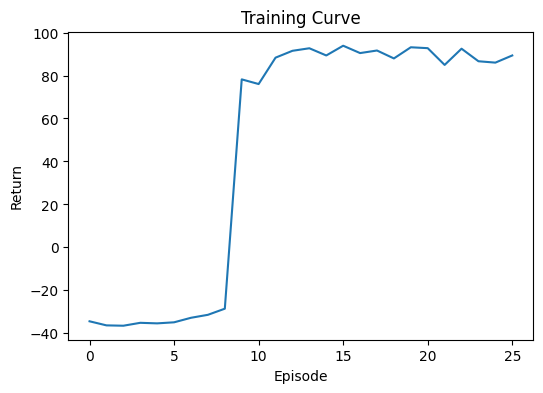

Eval Episode 0: Return=95.9, Success=1.0
Eval Episode 1: Return=95.8, Success=1.0
Eval Episode 2: Return=95.9, Success=1.0
Eval Episode 3: Return=93.3, Success=1.0
Eval Episode 4: Return=96.0, Success=1.0
Eval Episode 5: Return=92.0, Success=1.0
Eval Episode 6: Return=95.8, Success=1.0


  1%|▏         | 14/1000 [03:05<3:37:58, 13.26s/it]

Eval Episode 7: Return=94.3, Success=1.0
Eval Episode 8: Return=95.9, Success=1.0
Eval Episode 9: Return=95.1, Success=1.0
[Eval Epoch 15] Return: 95.0 ± 1.3, Success: 100.0%
Early stop condition met 5/5

EARLY STOPPING TRIGGERED!
Converged at epoch 15 with success rate 100.0%


In [70]:
def train(args=get_args()):
    # create env and dataset
    # env = gym.make(args.task_id, render_mode="human")
    train_env = gym.make(args.task_id)
    # obs, info = env.reset()

    # for _ in range(1000):
    # 	env.render()
    # 	action = env.action_space.sample()
    # 	obs, reward, terminated, truncated, info = env.step(action)
    # 	if terminated or truncated:
    # 		obs, info = env.reset()

    obs_dim = train_env.observation_space.shape[0]
    action_dim = train_env.action_space.shape[0]
    # print(f"obs dim: {obs_dim}, action dim: {action_dim}")

    # seed
    random.seed(args.seed)
    np.random.seed(args.seed)
    torch.manual_seed(args.seed)
    torch.cuda.manual_seed_all(args.seed)
    torch.backends.cudnn.deterministic = True
    # train_env.seed(args.seed)

    # # entropy regularization
    # if args.auto_alpha:
    # 	target_entropy = args.target_entropy if args.target_entropy \
    # 		else -np.prod(train_env.action_space.shape)
    # 	args.target_entropy = target_entropy
    # 	log_alpha = torch.zeros(1, requires_grad=True, device=args.device)
    # 	alpha_optim = torch.optim.Adam([log_alpha], lr=args.alpha_lr)
    # 	alpha = (target_entropy, log_alpha, alpha_optim)
    # else:
    # 	alpha = args.alpha

    agent = SACAgent(train_env, obs_dim, action_dim, args, args.device)

    buffer = ReplayBuffer(
        capacity=int(1e5),
        obs_dim=obs_dim,
        action_dim=action_dim,
        device=args.device
    )

    epochs = args.epoch
    steps_per_epoch = args.step_per_epoch
    start_steps =  args.start_steps 	# Warm-up exploration before SAC starts using its policy
    update_after = args.update_after  	# Do Not update SAC networks until the buffer has 1000 transitions
    update_every = args.update_every   	# Do SAC updates in batches every 50 environment steps
    batch_size = args.batch_size

    obs, _ = train_env.reset(seed=args.seed)
    episode_return = 0
    episode_length = 0
    global_step = 0

    success_history = []

    for epoch in tqdm(range(1, epochs + 1)):
        # Many episodes per epoch
        for step in range(steps_per_epoch):
            global_step += 1

            # ACTION SELECTION 
            if global_step < start_steps:
                # SAC does pure random exploration
                # No policy is used
                # No actor or critic updates
                # Since replay buffer is empty at the beginning
                action = train_env.action_space.sample()
            else:
                action = agent.act(obs)

            # ENV STEP
            next_obs, reward, terminated, truncated, info = train_env.step(action)
            done = terminated or truncated

            # INSERT INTO BUFFER
            buffer.add(obs, action, reward, next_obs, float(done))

            obs = next_obs
            episode_return += reward
            episode_length += 1

            # EPISODE END
            if done:
                success = float(obs[0] >= 0.45)   # success = 1 if goal reached
                success_history.append(success)
            
                print(f"[Epoch {epoch}] Episode Return: {episode_return:.1f}, "
                      f"Length: {episode_length}, Success: {success}")
            
                returns_history.append(episode_return)
                update_plot()
            
                obs, info = train_env.reset()
                episode_return = 0
                episode_length = 0

            # SAC UPDATE
            if global_step >= update_after and global_step % update_every == 0:
                # The critic needs at least some real trajectories to compute stable TD targets
                for _ in range(update_every):
                    batch = buffer.sample(batch_size)
                    stats = agent.update(batch)

        # END OF EPOCH: EVALUATION
        mean_ret, std_ret, eval_success_rate = evaluate_policy_continuous(
            args.task_id, agent,
            episodes=args.eval_episodes,
            render=False
        )
        
        print(f"[Eval Epoch {epoch}] Return: {mean_ret:.1f} ± {std_ret:.1f}, "
              f"Success: {eval_success_rate*100:.1f}%")
            
        # EARLY STOPPING
        if eval_success_rate >= EARLY_STOP_SUCCESS_RATE and mean_ret >= EARLY_STOP_RETURN_THRESHOLD:
            early_stop_counter += 1
            print(f"Early stop condition met {early_stop_counter}/{EARLY_STOP_PATIENCE}")
        else:
            early_stop_counter = 0
        
        # STOP TRAINING
        if early_stop_counter >= EARLY_STOP_PATIENCE:
            print("\n=========================================")
            print("EARLY STOPPING TRIGGERED!")
            print(f"Converged at epoch {epoch} with success rate {eval_success_rate*100:.1f}%")
            print("=========================================")
            break
    
    return agent

if __name__ == '__main__':
    trained_agent = train()

error: XDG_RUNTIME_DIR not set in the environment.


Eval Episode 0: Return=94.8, Success=1.0
Eval Episode 1: Return=94.5, Success=1.0
Eval Episode 2: Return=93.3, Success=1.0
Eval Episode 3: Return=91.5, Success=1.0
Eval Episode 4: Return=93.8, Success=1.0
Eval Episode 5: Return=96.0, Success=1.0
Eval Episode 6: Return=94.3, Success=1.0
Eval Episode 7: Return=96.0, Success=1.0
Eval Episode 8: Return=95.9, Success=1.0
Eval Episode 9: Return=93.4, Success=1.0
Saving GIF...


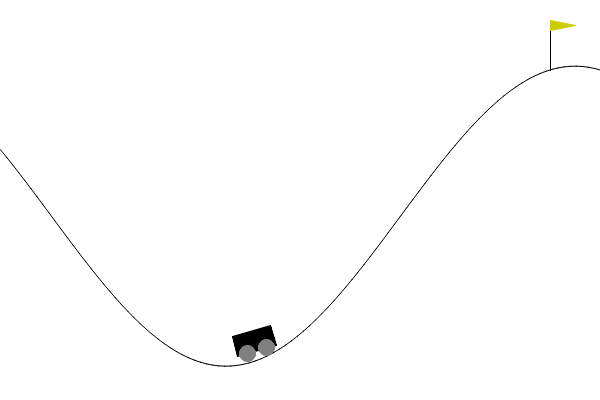

Return: 94.3 ± 1.4, Success: 100.0%


In [71]:
mean_ret, std_ret, eval_success_rate = evaluate_policy_continuous(
    "MountainCarContinuous-v0", trained_agent,
    episodes=10,
    render=True
)
        
print(f"Return: {mean_ret:.1f} ± {std_ret:.1f}, "
      f"Success: {eval_success_rate*100:.1f}%")


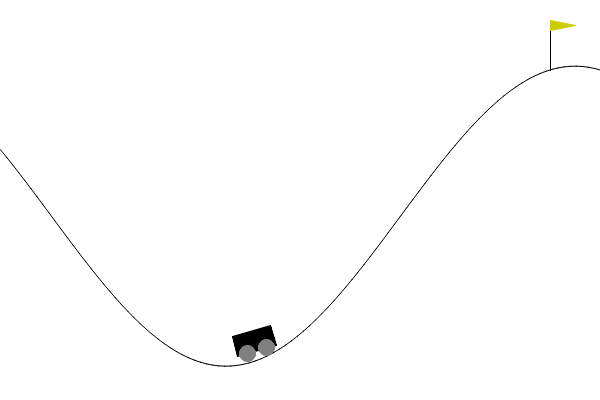

In [72]:
from IPython.display import HTML
import base64

path = "/kaggle/working/eval.gif"
gif = base64.b64encode(open(path,'rb').read()).decode('ascii')

HTML(f'<img src="data:image/gif;base64,{gif}" width="700px">')